# Manhattan EDA Part 2

The goal of this notebook is to look at staffing, quality and occupancy rate by location. 


Imports. 


In [58]:
import pandas as pd 

import matplotlib.pyplot as plt 

import seaborn as sns 

import numpy as np 

import plotly.express as px 

sns.set_context('talk')

plt.style.use('seaborn')

#setting custom color palette 

/var/folders/k6/3y0j37d96lqf05r_8yyfcqvh0000gn/T/ipykernel_4953/3727975229.py:13: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



In [59]:
#Import Data 

df = pd.read_csv('/Users/jack/Desktop/Data Analysis Practice/ManhattanProject/team_data.csv').infer_objects().drop_duplicates()

#convert columns to upper-case

df.columns = df.columns.str.upper()

#inspect data 

print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77051 entries, 0 to 77050
Data columns (total 67 columns):
 #   Column                                                           Non-Null Count  Dtype  
---  ------                                                           --------------  -----  
 0   CCN                                                              77051 non-null  int64  
 1   RURAL_VERSUS_URBAN                                               76975 non-null  object 
 2   PROFIT_LOSS                                                      76872 non-null  object 
 3   OWNERSHIP_TYPE                                                   77051 non-null  object 
 4   OWNERSHIP_TYPE_DETAIL                                            77051 non-null  object 
 5   PROVIDER_TYPE                                                    77051 non-null  object 
 6   PROVIDER_RESIDES_IN_HOSPITAL                                     77051 non-null  object 
 7   CONTINUING_CARE_RETIREMENT_COMMUNITY    

In [65]:
df.query('STATE_ID in ("FL","NY")')['STATE_ID'].value_counts()

STATE_ID
FL    3471
NY    2516
Name: count, dtype: int64

In [66]:
mask = df.isna().sum().sort_values(ascending=False) < 35_000


#dropping columns with more than 30% missing values, don't feel comfortable imputing these 
df = df\
  .loc[:,mask].set_index('CCN')

In [67]:
df.isna().sum().sort_values(ascending=False)[:20]

CONTRACT_LABOR                                                     27624
LESS_ALLOWANCES_FOR_UNCOLLECTIBLE_NOTES_AND_ACCOUNTS_RECEIVABLE    27461
TOTAL_OTHER_ASSETS                                                 26705
TOTAL_RUG_DAYS                                                     23596
ALLOWABLE_BAD_DEBTS                                                19374
TOTAL_AMOUNT_OF_FINES_IN_DOLLARS                                   11207
MOST_RECENT_HEALTH_INSPECTION_MORE_THAN_2_YEARS_AGO                11097
SNF_ADMISSIONS_TITLE_XIX                                           10879
FISCAL_YEAR_DAYS                                                    9912
TOTAL_FIXED_ASSETS                                                  8424
SNF_DAYS_TITLE_XIX                                                  7996
LESS_CONTRACTUAL_ALLOWANCE_AND_DISCOUNTS_ON_PATIENTS_ACCOUNTS       7638
TOTAL_DAYS_TITLE_XIX                                                7475
TOTAL_OTHER_INCOME                                 

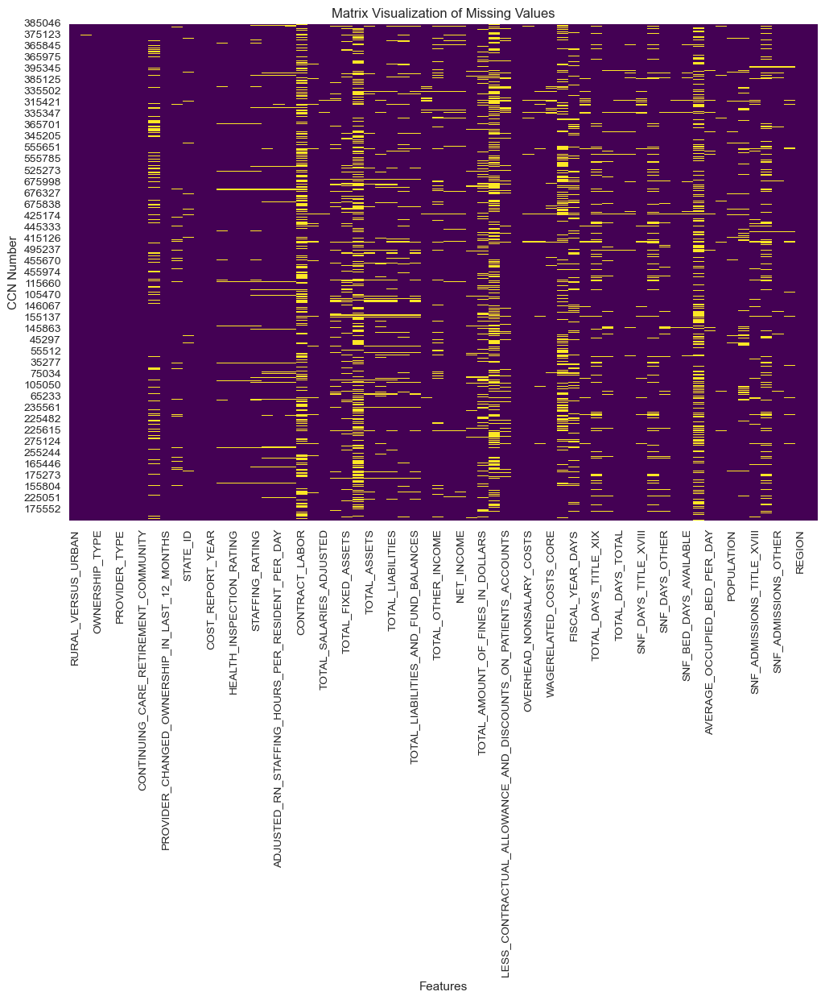

In [9]:
# Create the matrix plot using seaborn
plt.figure(figsize=(12,8))
sns.heatmap(df.isnull(), cmap='viridis', cbar=False)

plt.title('Matrix Visualization of Missing Values')

plt.xlabel('Features')

plt.ylabel('CCN Number')

plt.show()

In [10]:
#subsetting columns by category 

#rating columns 
rate_cols = ['OVERALL_RATING', 'HEALTH_INSPECTION_RATING',
       'QM_RATING', 'STAFFING_RATING']
       
#less items on balance sheet 
less_items = ['LESS_ALLOWANCES_FOR_UNCOLLECTIBLE_NOTES_AND_ACCOUNTS_RECEIVABLE',
       'LESS_CONTRACTUAL_ALLOWANCE_AND_DISCOUNTS_ON_PATIENTS_ACCOUNTS',
      'LESS_TOTAL_OPERATING_EXPENSE']
 
 #costs 
cost = ['OVERHEAD_NONSALARY_COSTS', 'TOTAL_COSTS',
       'WAGERELATED_COSTS_CORE','OPERATING_MARGIN']
 
 #staff ratings 
 
staffing =  ['ADJUSTED_LPN_STAFFING_HOURS_PER_RESIDENT_PER_DAY',
       'ADJUSTED_RN_STAFFING_HOURS_PER_RESIDENT_PER_DAY',
       'ADJUSTED_TOTAL_NURSE_STAFFING_HOURS_PER_RESIDENT_PER_DAY',
       #'ADJUSTED_NURSE_AIDE_STAFFING_HOURS_PER_RESIDENT_PER_DAY',
       'CONTRACT_LABOR']
  
  #length of stay or other days 
length_of_stay = ['FISCAL_YEAR_DAYS', 'TOTAL_DAYS_TITLE_XVIII', 'TOTAL_DAYS_TITLE_XIX',
      'TOTAL_DAYS_OTHER', 'TOTAL_DAYS_TOTAL', 'TOTAL_BED_DAYS_AVAILABLE',
      'SNF_DAYS_TITLE_XVIII', 'SNF_DAYS_TITLE_XIX', 'SNF_DAYS_OTHER',
       'SNF_DAYS_TOTAL', 'SNF_BED_DAYS_AVAILABLE', 'TOTAL_RUG_DAYS']
   
fines = ['NUMBER_OF_FINES', 'TOTAL_AMOUNT_OF_FINES_IN_DOLLARS',
        # 'TOTAL_NUMBER_OF_PENALTIES',
         #'NUMBER_OF_FACILITY_REPORTED_INCIDENTS',
        # 'NUMBER_OF_SUBSTANTIATED_COMPLAINTS'
         ]

#totals columns 
totals = ['TOTAL_CHARGES',
       'TOTAL_SALARIES_ADJUSTED', 'TOTAL_CURRENT_ASSETS', 'TOTAL_FIXED_ASSETS',
       'TOTAL_OTHER_ASSETS', 'TOTAL_ASSETS', 'TOTAL_CURRENT_LIABILITIES',
       'TOTAL_LIABILITIES', 'TOTAL_FUND_BALANCES',
       'TOTAL_LIABILITIES_AND_FUND_BALANCES',
       'TOTAL_GENERAL_INPATIENT_CARE_SERVICES_REVENUE',
       'TOTAL_OTHER_INCOME', 'TOTAL_INCOME','NET_INCOME','NET_OPERATING_MARGIN']

time_col = ['COST_REPORT_YEAR']

cat_cols = df.select_dtypes('object').columns.tolist() 

Clean operating margin for analysis 

In [11]:
def tukeys_fences(df,col):
    
    lower, upper = df[col].quantile([.25,.75]).values

    iqr = upper - lower 

    lower_lim = lower - iqr * 1.5

    upper_lim = upper + iqr * 1.5

    mask = (df[col] > upper_lim) | (df[col] < lower_lim)
    
    print(f'PCT of Outliers Detected in {col}: {mask.sum()/len(df):.3f}%')

    df.loc[mask,col] = np.nan
    
    return df 

# clean outliers from operating margin

In [12]:
df = tukeys_fences(df, col='OPERATING_MARGIN')

PCT of Outliers Detected in OPERATING_MARGIN: 0.028%


define categorical columns, we don't want to run tukey's on these. 

In [13]:
cont_cols = df.select_dtypes(include=[int,float]).columns

#clean outliers using tukey's fences, this includes our target variable 


#impute outliers using tukey's fences

for col in df[cont_cols]:
    
    # tukey's fences 
    
    df = tukeys_fences(df, col)

PCT of Outliers Detected in PROVIDER_ZIP_CODE.X: 0.000%
PCT of Outliers Detected in COST_REPORT_YEAR: 0.000%
PCT of Outliers Detected in OVERALL_RATING: 0.000%
PCT of Outliers Detected in HEALTH_INSPECTION_RATING: 0.000%
PCT of Outliers Detected in QM_RATING: 0.000%
PCT of Outliers Detected in STAFFING_RATING: 0.000%
PCT of Outliers Detected in ADJUSTED_LPN_STAFFING_HOURS_PER_RESIDENT_PER_DAY: 0.020%
PCT of Outliers Detected in ADJUSTED_RN_STAFFING_HOURS_PER_RESIDENT_PER_DAY: 0.032%
PCT of Outliers Detected in ADJUSTED_TOTAL_NURSE_STAFFING_HOURS_PER_RESIDENT_PER_DAY: 0.024%
PCT of Outliers Detected in CONTRACT_LABOR: 0.021%
PCT of Outliers Detected in TOTAL_CHARGES: 0.034%
PCT of Outliers Detected in TOTAL_SALARIES_ADJUSTED: 0.031%
PCT of Outliers Detected in TOTAL_CURRENT_ASSETS: 0.071%
PCT of Outliers Detected in TOTAL_FIXED_ASSETS: 0.116%
PCT of Outliers Detected in TOTAL_OTHER_ASSETS: 0.116%
PCT of Outliers Detected in TOTAL_ASSETS: 0.091%
PCT of Outliers Detected in TOTAL_CURRENT_

In [14]:
df.isna().sum().sort_values(ascending=False)[:50] # missing values after handling outliers 

TOTAL_OTHER_ASSETS                                                 35616
LESS_ALLOWANCES_FOR_UNCOLLECTIBLE_NOTES_AND_ACCOUNTS_RECEIVABLE    30081
CONTRACT_LABOR                                                     29279
TOTAL_AMOUNT_OF_FINES_IN_DOLLARS                                   27397
TOTAL_RUG_DAYS                                                     25698
ALLOWABLE_BAD_DEBTS                                                21854
TOTAL_FIXED_ASSETS                                                 17380
TOTAL_OTHER_INCOME                                                 15095
SNF_ADMISSIONS_TITLE_XIX                                           13420
TOTAL_LIABILITIES                                                  12998
TOTAL_FUND_BALANCES                                                12959
TOTAL_CURRENT_LIABILITIES                                          11405
LESS_CONTRACTUAL_ALLOWANCE_AND_DISCOUNTS_ON_PATIENTS_ACCOUNTS      11176
MOST_RECENT_HEALTH_INSPECTION_MORE_THAN_2_YEARS_AGO

In [15]:
#to make some visuals easier to read, lets group by regions we define 

# define regions 

southeast = [
"AR","LA","MS","AL","FL","GA","SC","TN","NC","KY","VA","WV","DC","DE"]

midwest = [
"ND","SD","NE","KS","MO","IA","MN","WI","IL","IN","MI","OH"
]
southwest = [
"AZ","NM","TX","OK"
]
west = [
"CA", "OR", "WA", "ID", "UT","NV","WY","MT","CO","AK","HI"]

In [16]:
df['REGION'] = df.STATE_ID.apply(lambda x: 'southwest' if x in southwest
                  else 'midwest' if x in midwest
                  else 'west' if x in west
                  else 'northeast')

list out columns to slice to examine different dimensions 

In [17]:
staff_cols = [#'adjusted_nurse_aide_staffing_hours_per_resident_per_day',
       'adjusted_lpn_staffing_hours_per_resident_per_day',
       'adjusted_rn_staffing_hours_per_resident_per_day',
       'adjusted_total_nurse_staffing_hours_per_resident_per_day']

rate_cols =['overall_rating', 'health_inspection_rating', 'staffing_rating',
       'rn_staffing_rating']

categorical_cols = ['provider_state', 'provider_type', 'with_a_resident_and_family_council',
       'ownership', 'op_type', 'rural_versus_urban', 
       'state_code', 'zip_code_y', 'medicare_cbsa_number', 'region',
       'type_of_control']


topten = ['TOTAL_DAYS_TITLE_XVIII', 'SNF_ADMISSIONS_OTHER', 'OCCUPANCY_RATE',
          'AVERAGE_NUMBER_OF_RESIDENTS_PER_DAY', 'ALLOWABLE_BAD_DEBTS',
        'NUMBER_OF_PAYMENT_DENIALS'] # top 10 features from xgboost model 

topten = [x.lower() for x in topten]

df.columns = df.columns.str.lower()

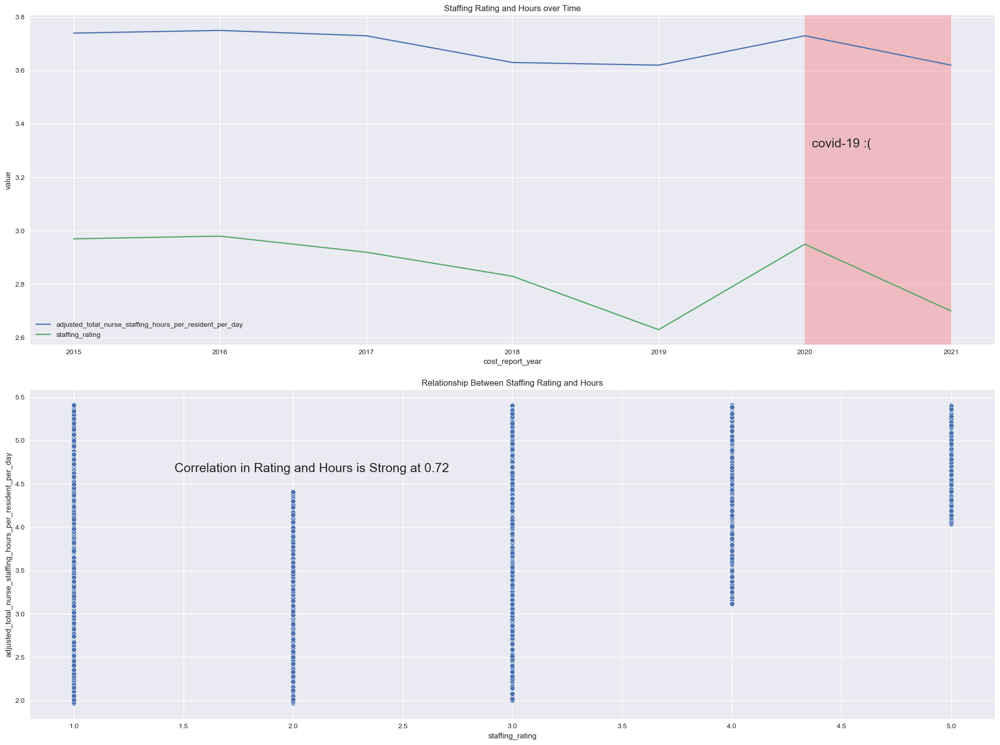

In [18]:
fig, ax = plt.subplots(ncols=1,nrows=2,figsize=(20,15))

# Assuming df is your DataFrame
staff = df.groupby(['cost_report_year'])[['adjusted_total_nurse_staffing_hours_per_resident_per_day',
                                      'staffing_rating']].mean().reset_index().round(2)

melt = staff.melt(id_vars='cost_report_year')

#look at staffing hours and rating over time 
sns.lineplot(melt, x='cost_report_year',y='value',hue='variable',ax=ax[0])

#make plot pretty 
ax[0].legend(loc='lower left')
ax[0].set_title('Staffing Rating and Hours over Time')
ax[0].grid(True) 

#highlight covid year
ax[0].axvspan(xmin=2020,xmax=2021,alpha=.2,color='red')
ax[0].text(transform=ax[0].transAxes,
           x=.81,
           y=.6,
           s='covid-19 :(')

#plot relationship 
sns.scatterplot(data=df,
                y='adjusted_total_nurse_staffing_hours_per_resident_per_day',
                x='staffing_rating')
#make plot pretty 
ax[1].set_title('Relationship Between Staffing Rating and Hours')
ax[1].grid(True)

#compute correlation to reinforce scatterplot 
corr = df[['adjusted_total_nurse_staffing_hours_per_resident_per_day',
                'staffing_rating']].corr(method='pearson').iloc[0,1]

#put corr on plot 

ax[1].text(transform=ax[1].transAxes,
           x=.15,
           y=.75,
           s=f'Correlation in Rating and Hours is Strong at {corr:.2f}')

fig.tight_layout()

In [19]:
#it looks like staffing rating is highly correlated with staffing hours as expected 

#lets see how covid impacted our staffing

df.groupby('covid')[staff_cols]\
    .mean().T.round(3) # not much of a difference to see here 

covid,Covid,Non-Covid
adjusted_lpn_staffing_hours_per_resident_per_day,0.894,0.997
adjusted_rn_staffing_hours_per_resident_per_day,0.557,0.507
adjusted_total_nurse_staffing_hours_per_resident_per_day,3.654,3.712


occupancy, admissions and payment denials all had significant shifts pre and post covid. 

/Users/jack/tensorflow-test/env/lib/python3.8/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


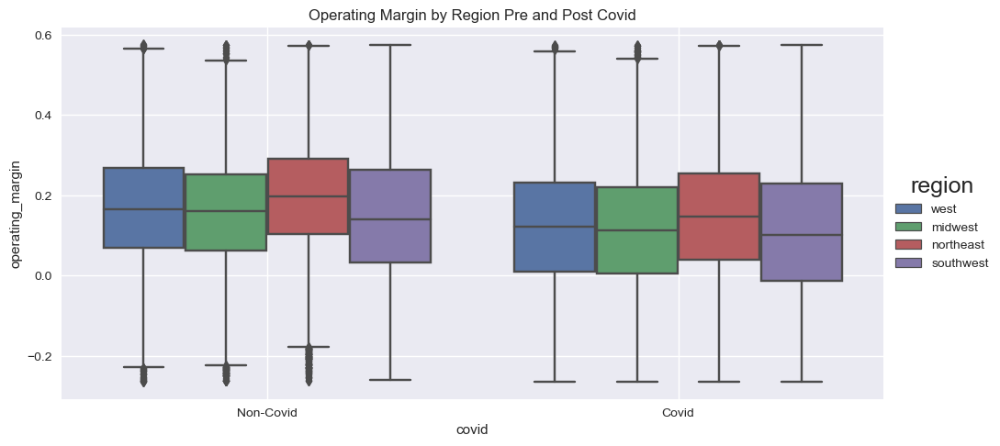

covid,Covid,Non-Covid
count,31097.0000,42413.0000
mean,0.1277,0.1740
std,0.1598,0.1466
min,-0.2653,-0.2648
25%,0.0182,0.0763
50%,0.1279,0.1761
75%,0.2375,0.2736
max,0.5756,0.5759


In [20]:
sns.catplot(data=df,
            x='covid',
            y='operating_margin',
            hue='region',
            aspect=2,
            height=5,
            kind='box')

plt.title('Operating Margin by Region Pre and Post Covid')

plt.grid(True)

plt.show() 

df.groupby('covid')['operating_margin'].describe().T.round(4)

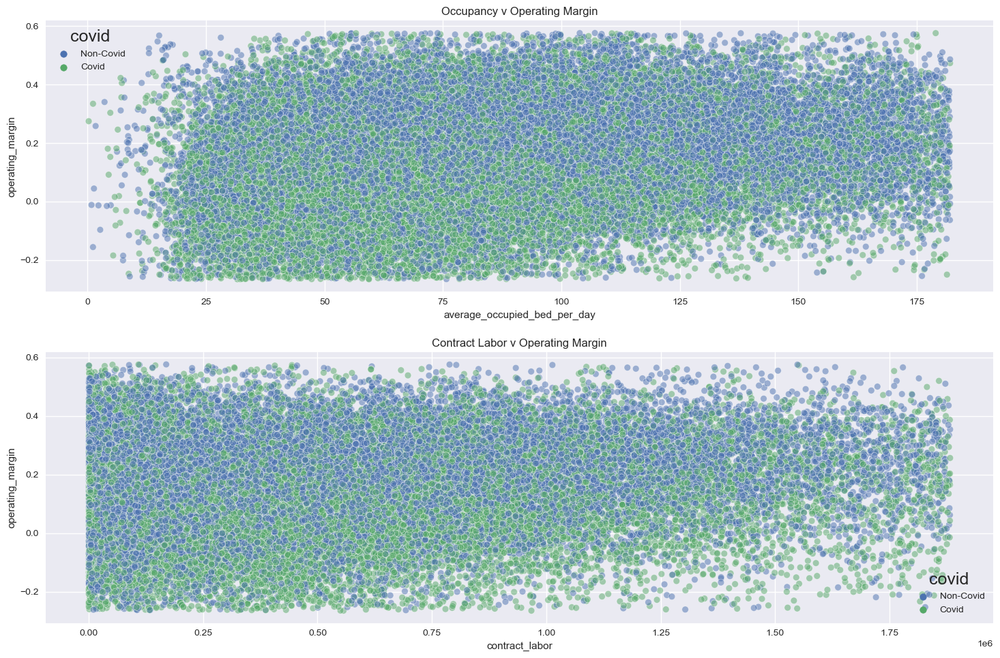

In [21]:
#why did operating margin take such a dive, costs, attendance, revenue or all 3? 

fig, ax = plt.subplots(ncols=1,nrows=2,figsize=(15,10))

sns.scatterplot(df,
                y='operating_margin',
                x='average_occupied_bed_per_day',
                hue='covid',
                alpha=.5,
                ax=ax[0])

ax[0].set_title('Occupancy v Operating Margin')

sns.scatterplot(df,
                x='contract_labor',
                y='operating_margin',
                hue='covid',
                alpha=.5,
                ax=ax[1])

ax[1].set_title('Contract Labor v Operating Margin')

fig.tight_layout()

#contract labor went up in covid and op margin was mostly negative 

#occupancy also went down big time in covid along with operating margin

rural_versus_urban      R                U          
covid               Covid Non-Covid  Covid Non-Covid
mean                0.105     0.149  0.135     0.183
std                 0.153     0.140  0.161     0.148
min                -0.265    -0.264 -0.265    -0.265
25%                 0.001     0.056  0.025     0.085
50%                 0.107     0.153  0.136     0.185
75%                 0.208     0.243  0.247     0.285

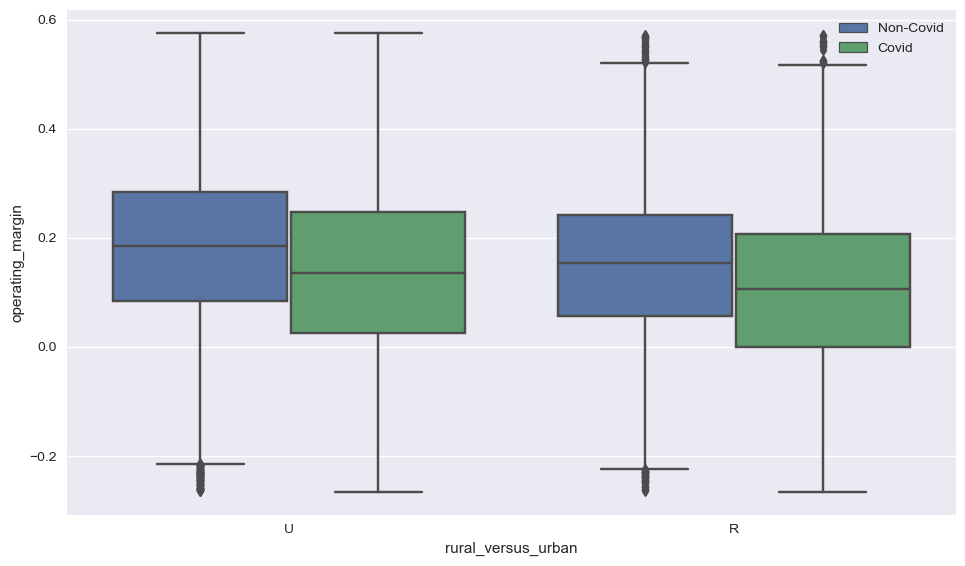

In [22]:
#looking at rural v urban 
plt.figure(figsize=(10,6))
sns.boxplot(df, 
            x = 'rural_versus_urban',
            y='operating_margin',
            hue='covid')

plt.tight_layout()

plt.legend(loc='upper right')

df.groupby(['rural_versus_urban','covid']).operating_margin\
    .describe().round(3).T.loc['mean':'75%'] # it doesn't seem like rural versus urban took disproportionate hits in performance.
    
    # Urban does show better investment, naturally. THis is dvident in higher median and mean

In [23]:
# cut operating margin into good and bad performers 

df = df.assign(fin_bins = pd.qcut(df['operating_margin'],
                             q=3,labels=['Dog','Avg','Star']))

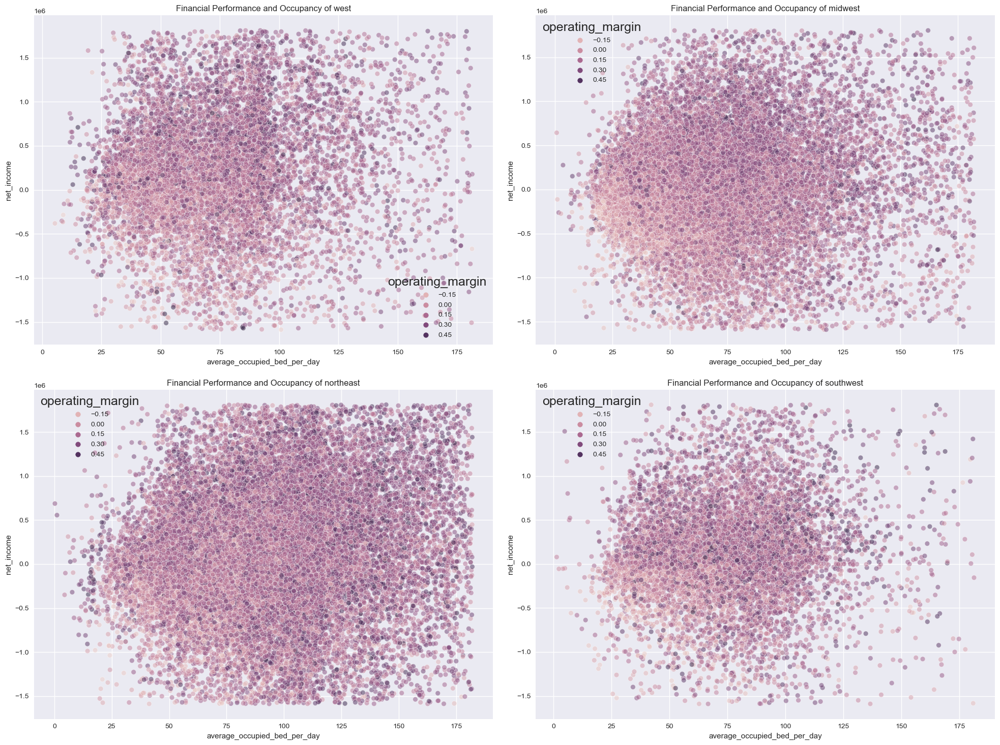

In [24]:
#lets examine regional relationship between operating margin and occupancy 

fig, ax = plt.subplots(figsize=(20,15),ncols=2,nrows=2)

#flatten axes for easier plotting 
ax = ax.flatten()

for i,reg in enumerate(df.region.unique()): 
    
    regional = df[df.region == reg]
    
    sns.scatterplot(regional,
                    y='net_income',
                    x='average_occupied_bed_per_day',
                    ax=ax[i],
                    hue='operating_margin',
                    alpha=.5)
    
    ax[i].set_title(f'Financial Performance and Occupancy of {reg}')
    
plt.tight_layout()

plt.show()

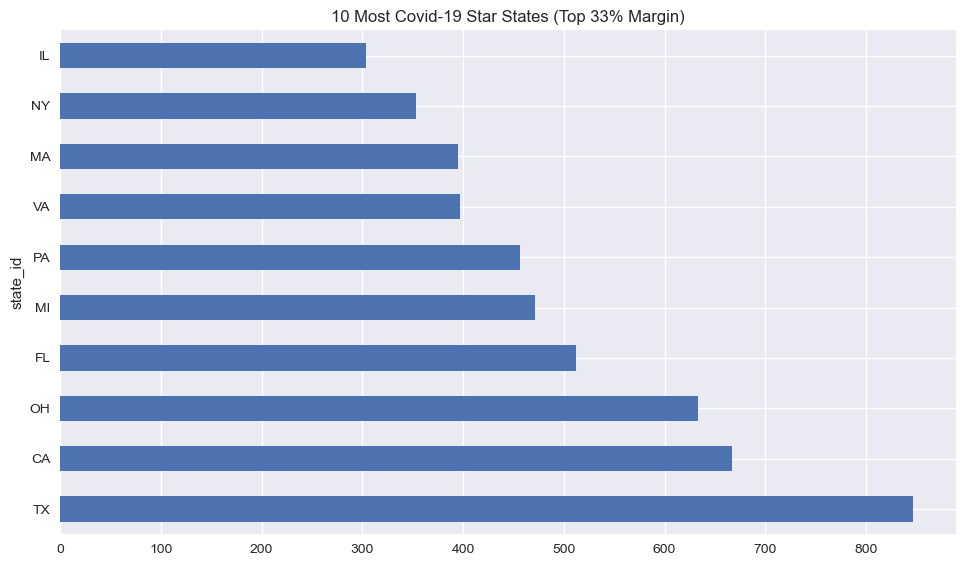

In [25]:
new = df.groupby(['covid','fin_bins','state_id'])[['average_occupied_bed_per_day','operating_margin']].agg(avg_margin = ('operating_margin','mean'),
                                                count_of_facil = ('operating_margin','count'),
                                                mean_occupancy = ('average_occupied_bed_per_day','mean')).round(3)

covid_stars = new.loc['Covid','Star']\
    .sort_values(by='count_of_facil',ascending=False)
    
ax = covid_stars[:10]['count_of_facil'].plot(kind='barh',
                                        figsize=(10,6),
                                        title='10 Most Covid-19 Star States (Top 33% Margin)') 
    
    
plt.tight_layout()

plt.show()

# what did these states do better than other states? These are historically the most resilient states to a "Black Swan Event" such as covid-19

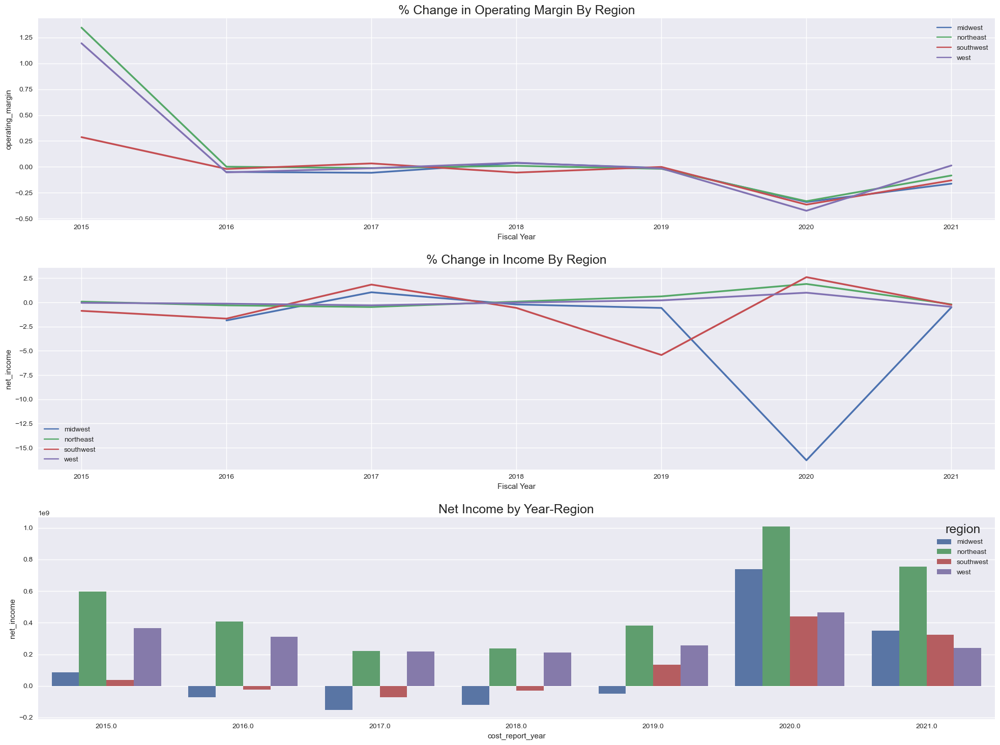

In [26]:
pct = df.groupby(['region','cost_report_year'])\
    [['average_occupied_bed_per_day',
      'net_income',
      'operating_margin']\
        ].mean()[['average_occupied_bed_per_day',
                                                              'net_income',
                                                              'operating_margin']]\
                                                                  .pct_change().reset_index()
                                                                  
regional_income = df.groupby(['region',
                              'cost_report_year'])[['net_income']]\
  .sum().reset_index()
  
fig, ax = plt.subplots(
                       nrows=3,
                       figsize=(20,15))

ax = ax.flatten()


#plot results as a trace 

sns.barplot(regional_income,x='cost_report_year',y='net_income',hue='region',ax=ax[2])

ax[2].set_title('Net Income by Year-Region',fontsize=18)

sns.lineplot(pct,x='cost_report_year',
        y='operating_margin',
        ax=ax[0],
        hue='region',
        markers='.',
        linewidth=2.5)

sns.lineplot(pct,x='cost_report_year',
        y='net_income',ax=ax[1],
        hue='region',
        markers='.',
        linewidth=2.5)

ax[0].set_title(f'% Change in Operating Margin By Region',fontsize=18)

ax[1].set_title(f'% Change in Income By Region',fontsize=18)

ax[0].set_xlabel('Fiscal Year')

ax[0].legend()

ax[1].set_xlabel('Fiscal Year')

ax[1].legend()

fig.tight_layout() 
    
    

# Liquidity Ratios:

* Current Ratio: Current Assets / Current Liabilities
* Quick Ratio (Acid-Test Ratio): (Current Assets - Inventory) / Current Liabilities
# Profitability Ratios:

* Gross Profit Margin: (Gross Profit / Revenue) * 100
* Net Profit Margin: (Net Profit / Revenue) * 100
* Return on Equity (ROE): (Net Income / Shareholders' Equity) * 100
* Return on Assets (ROA): (Net Income / Total Assets) * 100
# Efficiency Ratios:

* Asset Turnover Ratio: Revenue / Total Assets
* Inventory Turnover Ratio: Cost of Goods Sold / Average Inventory
* Accounts Receivable Turnover Ratio: Revenue / Average Accounts Receivable
# Solvency Ratios:

* Debt-to-Equity Ratio: Total Debt / Shareholders' Equity
* Interest Coverage Ratio: EBIT (Earnings Before Interest and Taxes) / Interest Expense
* Debt Ratio: Total Debt / Total Assets
# Market Value Ratios:

* Price-to-Earnings (P/E) Ratio: Market Price per Share / Earnings per Share (EPS)
* Price-to-Book (P/B) Ratio: Market Price per Share / Book Value per Share
* Dividend Yield: Dividend per Share / Market Price per Share

<Axes: title={'center': 'Inflated Cost Items in NorthEast or MidWest (Covid)'}>

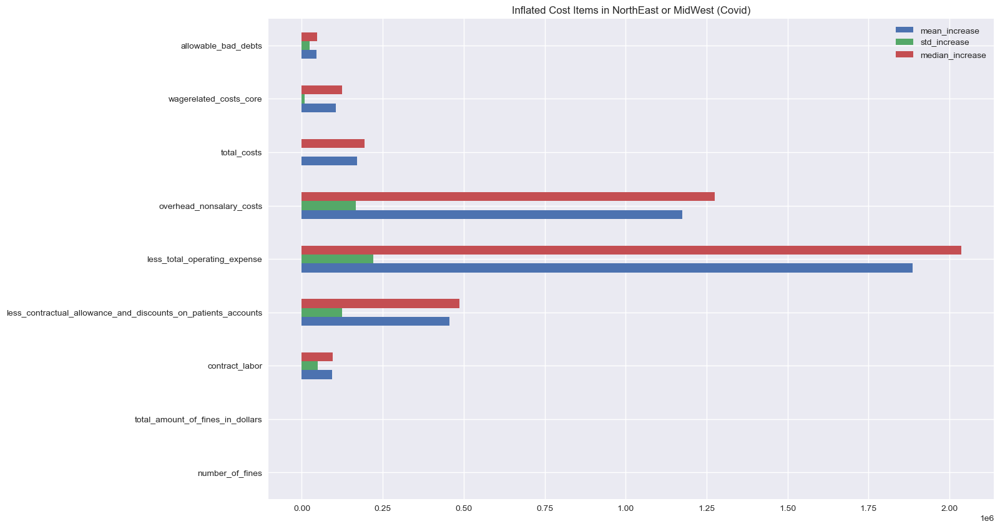

In [27]:
cost_drivers = ['number_of_fines',
       'total_amount_of_fines_in_dollars', 'contract_labor',
        'less_contractual_allowance_and_discounts_on_patients_accounts',
       'less_total_operating_expense', 'overhead_nonsalary_costs',
       'total_costs', 'wagerelated_costs_core', 'allowable_bad_debts']

covid_mask = (df.region == "northeast") | (df.region == 'midwest') & (df.cost_report_year > 2019)

#subset for east and midwest regions in covid time to understand what drove costs up. 

cov_table = df.loc[covid_mask][cost_drivers].describe().T

non_cov_table = df.loc[~covid_mask][cost_drivers].describe().T[['mean','std','50%']]

covid_diff = cov_table[['mean','std','50%']] - non_cov_table

covid_diff.columns = ['mean_increase','std_increase','median_increase']

covid_diff.plot(kind='barh',
                
                figsize=(15,10),
                
                title='Inflated Cost Items in NorthEast or MidWest (Covid)')

lets look at things potentially correlated with our 3 columns of interest. overhead, operating expense and contractual allowance.

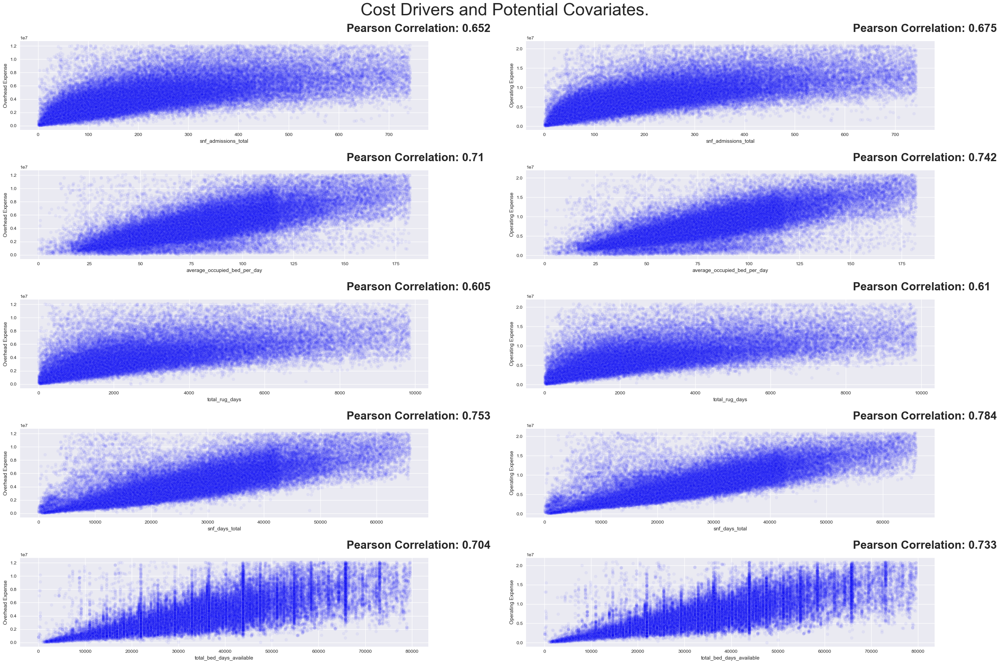

In [28]:
#define 3 key cost drivers to look at
cost_drivers = ['overhead_nonsalary_costs','less_total_operating_expense']

#define covariate list 
covs = [
       #'population', 
       #'snf_admissions_title_xviii', 
      # 'snf_admissions_title_xix', 
       'snf_admissions_total',
       'average_occupied_bed_per_day',
      # 'qm_rating',
       'total_rug_days',
       'snf_days_total',
       'total_bed_days_available'
       ]

fig, ax = plt.subplots(ncols=len(cost_drivers),nrows=len(covs),figsize=(30,20))

for i, driver in enumerate(cost_drivers): 
    
    for j, cov in enumerate(covs):
        
        #compute correlation 
        corr_coef = df[[driver,cov]].corr().iloc[0,1].round(3)
        
        #plot scatter grid 
    
        sns.scatterplot(data=df,
                        x=cov,
                        y=driver,
                        ax=ax[j,i],
                        alpha=.05,
                        color='blue',
                        markers='o')
        
        #add pearson correlation to plot 
        
        ax[j,i].text(transform=ax[j,i].transAxes,
                     x=.8,
                     y=1.1,
                     s=f'Pearson Correlation: {corr_coef}',
                     fontweight='bold',
                     fontsize=24)
        
        # Set global y-axis label for the first column
        if i == 0:
            ax[j, i].set_ylabel('Overhead Expense') 
        else: 
            ax[j, i].set_ylabel('Operating Expense')
        
        
fig.suptitle('Cost Drivers and Potential Covariates.',fontsize=36)
        
fig.tight_layout()

The most important skill to cultivate when working in data is....



Asking the right questions, then leveraging your tech-stack to attempt to answer them. 



The below scatter grid was a product of: 



"What factors are driving my two largest cost items, operating and overhead? (costs)"



The result? We see multiple covariates have strong linear relationships with our cost items of interest. 



What skill do you feel is crucial for data science/analysis?  



#datascience #visualization #python 

Text(0.5, 1.0, 'northeast Relation in Occupancy/Cost and Profit')

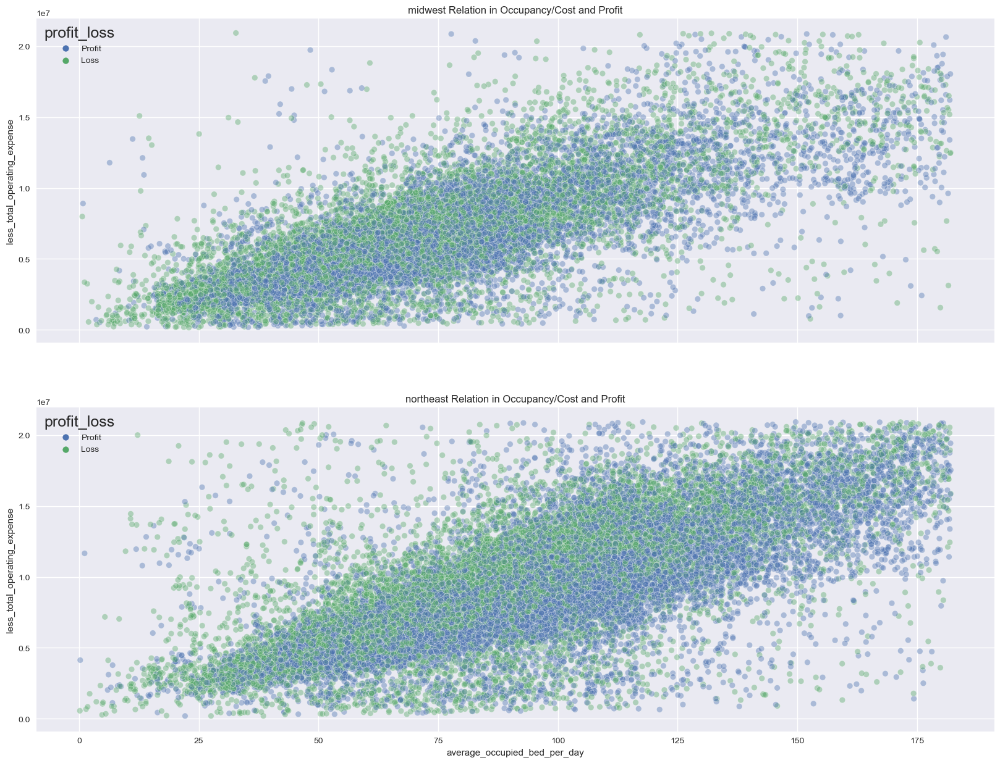

In [29]:
# at what point of occupancy did facilities start losing money ? 

fig, ax = plt.subplots(nrows=2,figsize=(20,15),sharey=True,sharex=True)

sns.scatterplot(df.query('region == "midwest"'),
                x='average_occupied_bed_per_day',
                y='less_total_operating_expense',
                hue='profit_loss',
                alpha=.4,
                ax=ax[0])


ax[0].set_title('midwest Relation in Occupancy/Cost and Profit')

sns.scatterplot(df.query('region == "northeast"'),
                x='average_occupied_bed_per_day',
                y='less_total_operating_expense',
                hue='profit_loss',
                alpha=.4,
                ax=ax[1])

ax[1].set_title('northeast Relation in Occupancy/Cost and Profit')

In [30]:
profit_ratio = df.groupby('region')\
    [['profit_loss']]\
        .value_counts(normalize=True).round(2).reset_index()
        
px.bar(profit_ratio,x='region',
       y='proportion',
       color='profit_loss',
       title='Profitable vs UnProfitable Proportion',
       barmode='group')

snf_days_total                    average_occupied_bed_per_day  \
                    mean   median       std                         mean   
region                                                                     
midwest         23089.14  21298.0  12289.65                        71.42   
southwest       23477.46  23240.0  11741.76                        73.52   

                        total_bed_days_available                     
          median    std                     mean   median       std  
region                                                               
midwest    66.34  33.01                 33419.42  32850.0  15499.92  
southwest  72.50  29.29                 37558.52  39785.0  14895.23

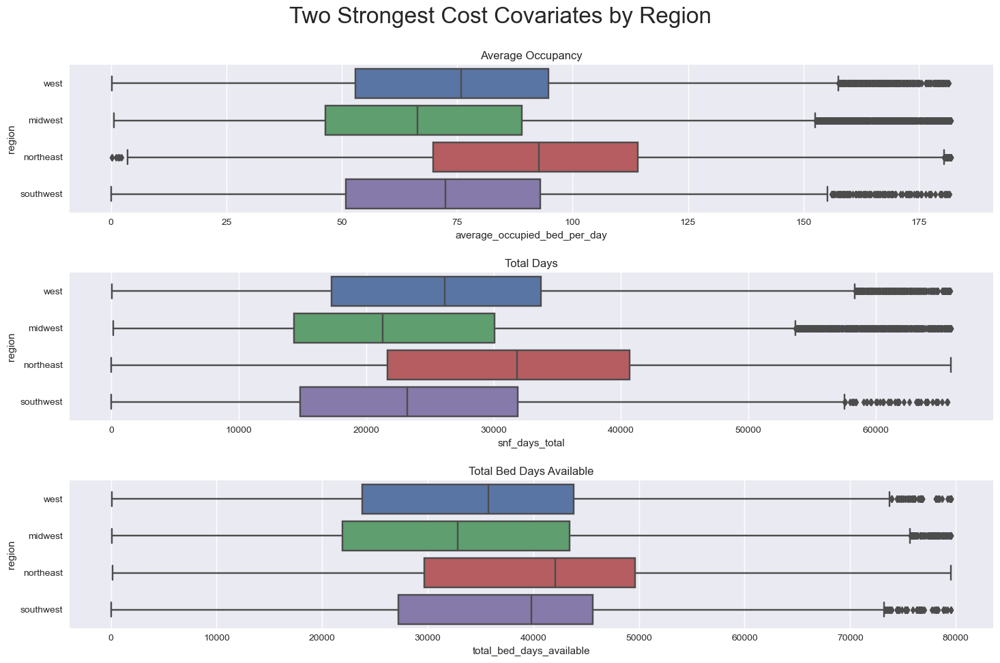

In [31]:
#plot regional differences in covariates driving costs 

fig, ax = plt.subplots(nrows=3,figsize=(15,10))

#1st boxplot of avg occ and title 
sns.boxplot(df,y='region',x='average_occupied_bed_per_day',ax=ax[0],orient='h')

ax[0].set_title('Average Occupancy')

#2nd box plot of total days and title 
sns.boxplot(df,y='region',x='snf_days_total',ax=ax[1],orient='h')

ax[1].set_title('Total Days')

fig.suptitle('Two Strongest Cost Covariates by Region',fontsize=24)

#3rd box plot and title 
sns.boxplot(df,y='region',x='total_bed_days_available',ax=ax[2],orient='h')

ax[2].set_title('Total Bed Days Available')

plt.tight_layout() 

#display summary able above plots to see the differences 
df.query('region in ("southwest","midwest")').groupby('region')\
    [['snf_days_total',
      'average_occupied_bed_per_day',
      'total_bed_days_available']].agg(['mean','median','std']).round(2)

# A closer look at revenue

we see the east has higher bed days, occupancy and total days. The south is not far behind though. What could be explaining revenue in these regions? 


In [32]:
covariates = df.select_dtypes(include=[int,
                                       float])\
                                           .corr()\
                                               .loc['net_income'].sort_values(ascending=False, #sorting values by absolute corr descending, filtering out obvious correlations
                                                                              key=lambda x: abs(x))[2:20]
                                               
                                               
covariates

total_fund_balances                              0.431023
total_current_assets                             0.240081
operating_margin                                 0.220558
total_assets                                     0.189419
total_liabilities_and_fund_balances              0.189266
snf_days_title_xviii                             0.154009
total_days_title_xviii                           0.153951
total_rug_days                                   0.153789
total_days_total                                 0.136619
snf_days_total                                   0.135320
health_inspection_rating                         0.132142
total_liabilities                               -0.121516
total_general_inpatient_care_services_revenue    0.116515
average_occupied_bed_per_day                     0.113614
overall_rating                                   0.109786
total_salaries_adjusted                          0.098562
total_charges                                    0.098325
total_other_in

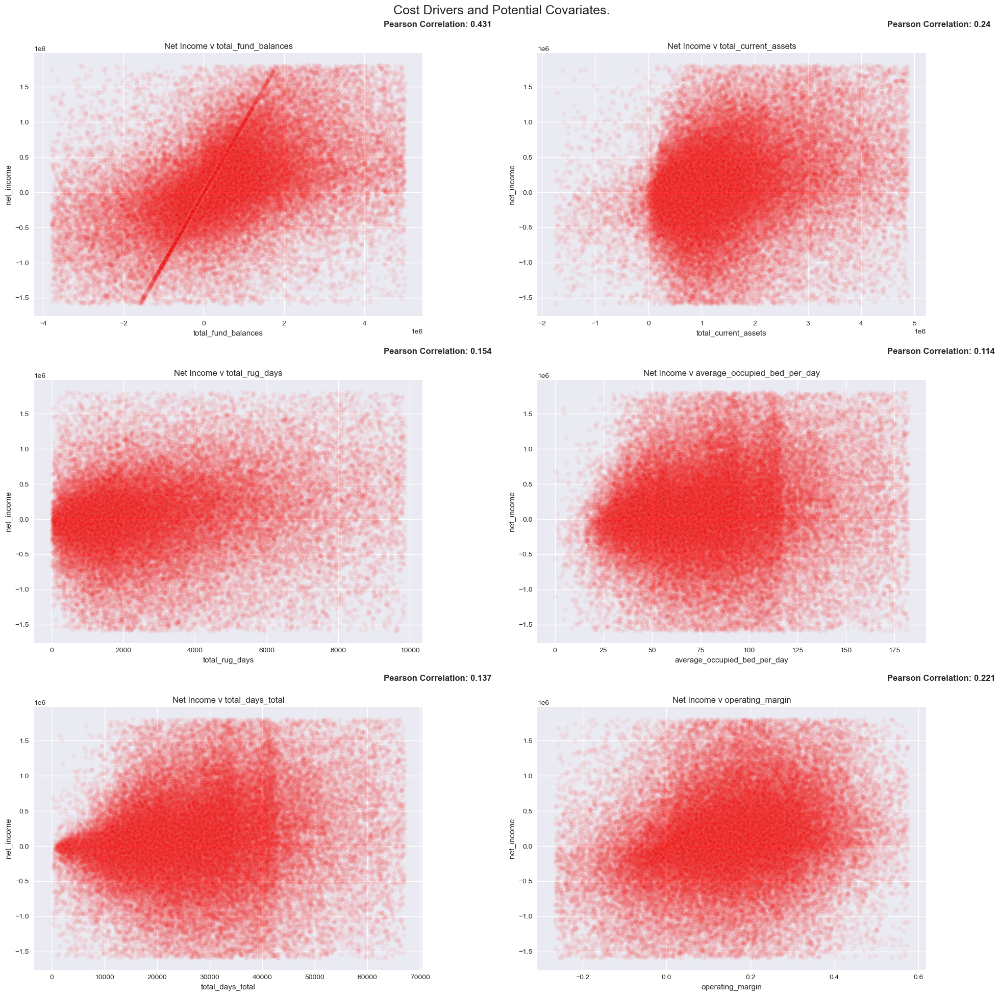

In [33]:
#define 3 key cost drivers to look at
revenue = ['net_income']

#define covariate list 
covs = [
       'total_fund_balances', #this relationship is relatively strong 
       'total_current_assets', # this relationship is strong 
       'total_rug_days',
       # 'total_liabilities',  weak relationship 
     # 'overall_rating', very weak relationship 
       'average_occupied_bed_per_day',
       'total_days_total',
      # 'total_bed_days_available', very weak relationship 
       'operating_margin'
       ] 

fig, ax = plt.subplots(ncols=2 ,nrows=(len(covs) + 1) // 2 ,figsize=(20,20))


for i, cov in enumerate(covs):
        
        #compute correlation 
        corr_coef = df[['net_income',cov]].corr().iloc[0,1].round(3)
        
        ax = ax.flatten()
        
        #plot scatter grid 
    
        sns.scatterplot(data=df,
                        x=cov,
                        y='net_income',
                        ax=ax[i],
                        alpha=.05,
                        color='red',
                        markers='o')
        
        #add pearson correlation to plot 
        
        ax[i].set_title(f'Net Income v {cov}')
        
        ax[i].text(transform=ax[i].transAxes, # place pearson r coef in the top right of each scatter 
                     x=.9,
                    y=1.1,
                    s=f'Pearson Correlation: {corr_coef}',
                    fontweight='bold',
                    fontsize=12)
        
fig.suptitle('Cost Drivers and Potential Covariates.',fontsize=18)
        
fig.tight_layout()

this is a bit surprising to see. We don't find much in terms of our two biggest changing cost items being correlated with income. I expected a sizeable negative correlation. 

It looks like total fund balances may lead us down the path of a firm managing assets well. Lets look there next. 

Define Ratios to assess different aspects of business

In [34]:
# define ratios 

df = df.assign(
income_to_cost = df['total_income'].div(df['total_costs']), #profitability 

          current_ratio = df['total_current_assets'].div(df['total_current_liabilities']), # liquidity 
          
          return_on_assets = df['net_income'].div(df['total_assets']), # profitability 
          
          inpatient_margin = df['total_income'].div(df['total_general_inpatient_care_services_revenue']))

#subset ratios for analysis 

ratios = ['income_to_cost', 'current_ratio',
       'return_on_assets', 'inpatient_margin']

In [35]:
display(df[ratios].describe()) # notice the small IQR and HUGE min/max values

#for now we will utilize tukey's fences on this. 

for col in df[ratios].columns: 
    
    # tukey's fences 
    
    df = tukeys_fences(df, col)

,income_to_cost,current_ratio,return_on_assets,inpatient_margin
count,66943.000000,60927.000000,61272.000000,66164.000000
mean,0.072154,0.275900,-1.186047,-0.007572
std,4.492689,486.284138,543.263094,1.173796
min,-294.263604,-117366.250000,-124800.000000,-174.499377
25%,-0.317172,0.757610,-0.115859,-0.047756
50%,0.096899,1.307851,0.050266,0.014931
75%,0.484729,2.200318,0.220113,0.072937
max,986.413437,24352.000000,50052.384615,5.117666


PCT of Outliers Detected in income_to_cost: 0.062%
PCT of Outliers Detected in current_ratio: 0.070%
PCT of Outliers Detected in return_on_assets: 0.081%
PCT of Outliers Detected in inpatient_margin: 0.042%


visualize the pct change difference by region and profit flag 

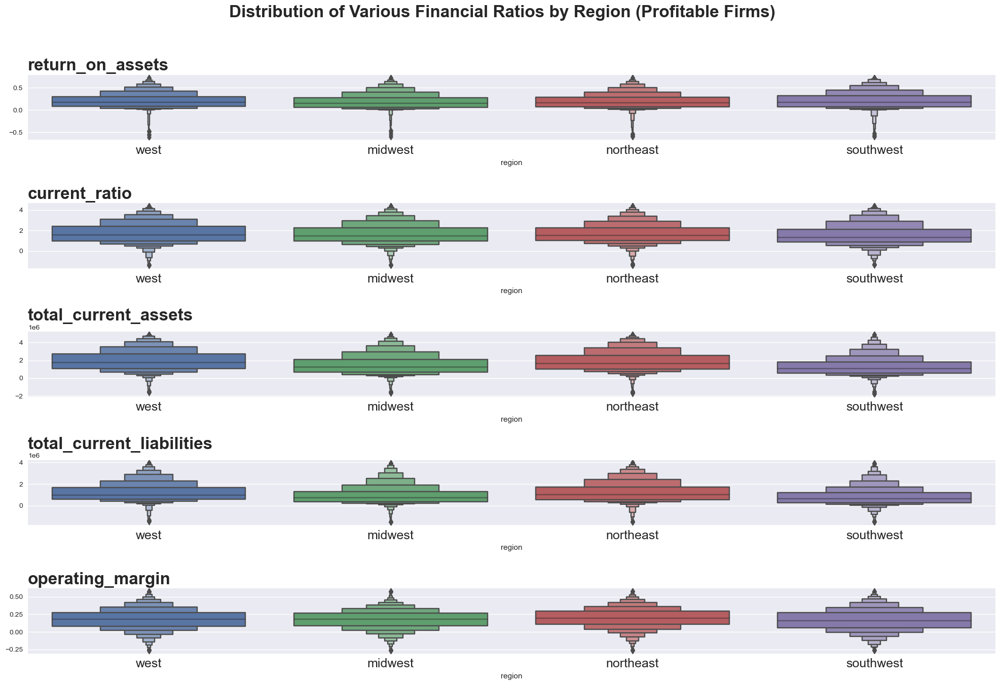

In [36]:
fig, ax = plt.subplots(nrows=5,figsize=(20,20))

cols_to_plot = ['return_on_assets','current_ratio','total_current_assets','total_current_liabilities','operating_margin']

for i, col in enumerate(df[cols_to_plot]):
    
    for_profit = df.query('profit_loss == "Profit"')
    
    #get summary value (median) for strong investments 
    summary = for_profit[cols_to_plot].describe().T.loc[col]
    
    ideal = summary['50%'].round(2)
    
    annot = f'Strong investments have a {col} >= {ideal}'
    
    #custom annotations for each plotting element (if in millions )
    if col in ['total_current_liabilities','total_current_assets']:
        
        ideal = round(ideal / 1e6,2)
        
        annot = f'Strong investments have a {col} >= {ideal}M'
        
        if col == 'total_current_liabilities': 
        
            annot = f'Strong investments have a {col} ~ {ideal}M'
    
    #plot boxen plot of how this ratio is compared in for profit firms by region 
    sns.boxenplot(for_profit,
                x='region',
                y=col,
                ax=ax[i])

    ax[i].set_title(col,loc='left',fontweight='bold',fontsize=24)
    
    ax[i].set_ylabel('')
    ax[i].tick_params(axis='x', labelsize=18)

    #ax[i].text(0.5, 1.1,
     #          s= annot, # custom annotation
     #          fontsize=18, fontweight='bold', transform=ax[i].transAxes,
     #          bbox=dict(facecolor='white', alpha=0.8))

fig.suptitle('Distribution of Various Financial Ratios by Region (Profitable Firms)',
             fontsize=24,
             fontweight='bold')

fig.tight_layout(rect=[0,0.3,1,.97])

* we see that firms likely to be profitable meet a certain set of requirements. Lets filter our dataset on these and find other similarities in them.

In [37]:
#define various masks to filter on (we will only use these three (all ratios), we will not filter on liabilities as they are indicative of firm size)

roa_mask = df.return_on_assets >= .16

current_mask = df.current_ratio >= 1.48

operating_margin_mask = df.operating_margin >= .18

In [38]:
#filter for best facilities 

#this is the highest quality investment sample we find 

df1 = df.loc[roa_mask &  current_mask & operating_margin_mask]

profit_proportion = df1[['profit_loss','region']]\
    .value_counts(normalize=True).round(3) # simply put we see the best investments live in the northeast and midwest

# lets utilize causal inference to look at what was in our new sample 

* H0 is set as the profitable group has a higher average value for column

* HA allows us to presume the less profitable group has a higher than average value for a column

In [39]:
#test non-financial columns that are affecting profitability at 99% confidence 

cols_to_test = ['overall_rating',
 'health_inspection_rating',
 'qm_rating',
 'staffing_rating',
 'adjusted_lpn_staffing_hours_per_resident_per_day',
 'adjusted_rn_staffing_hours_per_resident_per_day',
 'adjusted_total_nurse_staffing_hours_per_resident_per_day',
 'contract_labor',
 'number_of_fines',
 'total_amount_of_fines_in_dollars',
 'total_days_total',
 'total_bed_days_available',
 'total_rug_days',
 'average_occupied_bed_per_day',
 'population',
 'density']

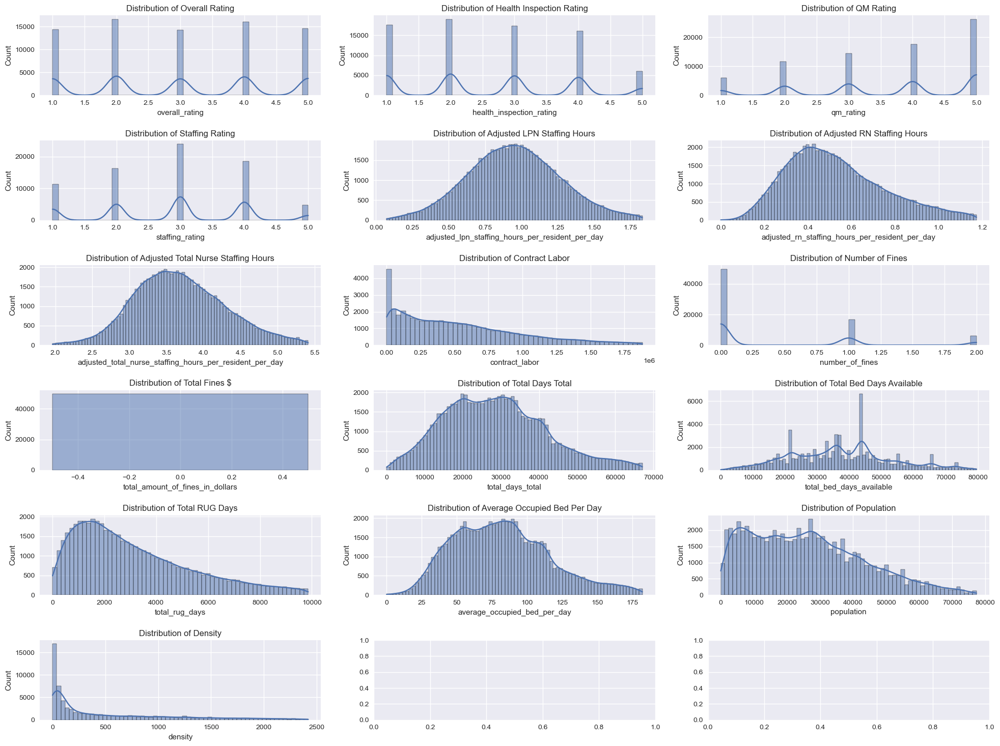

In [40]:
fig, ax = plt.subplots(ncols=3,nrows=(len(cols_to_test) + 2) // 3, figsize=(20,15))

ax = ax.flatten()

column_titles = {
    'health_inspection_rating': 'Health Inspection Rating',
    'total_days_total': 'Total Days Total',
    'total_rug_days': 'Total RUG Days',
    'number_of_fines': 'Number of Fines',
    'overall_rating': 'Overall Rating',
    'average_occupied_bed_per_day': 'Average Occupied Bed Per Day',
    'qm_rating': 'QM Rating',
    'adjusted_rn_staffing_hours_per_resident_per_day': 'Adjusted RN Staffing Hours',
    'staffing_rating': 'Staffing Rating',
    'adjusted_total_nurse_staffing_hours_per_resident_per_day': 'Adjusted Total Nurse Staffing Hours',
    'adjusted_lpn_staffing_hours_per_resident_per_day': 'Adjusted LPN Staffing Hours',
    'total_bed_days_available': 'Total Bed Days Available',
    'density': 'Density',
    'contract_labor':'Contract Labor',
    'total_amount_of_fines_in_dollars':'Total Fines $',
    'population':'Population'
}

for i, col in enumerate(cols_to_test): 
    
    sns.histplot(df[col],kde=True,ax=ax[i])
    
    ax[i].set_title(f'Distribution of {column_titles[col]}')
    
fig.tight_layout()

* categoricals follow a uniform distribution and it seems that our continuous data is skewed, only showing normality in a few columns. 


* Lets use median as robust measure of centrality. 

In [41]:
#group df by provider number and average columns across all years.

pre = df.query('cost_report_year < 2020')

grouped = (pre.groupby(['profit_loss',pre.index]) # group by profit loss and provider number 
        [cols_to_test].median().reset_index())
        
# we grouped this way to control for covid related effects. We are more interested in nursing home investment viability outside of black swan events. 

* group data this way to run independent sample t-test on aggregated diff across ALL years pre-covid

* group by profit or loss then by provider ID

* use median as its a robust measure of centrality as seen by the distributions

In [42]:
# run tests 

#import pingouin 

import pingouin as pg 

#H0: we assume that the dependant var explains none of the variance in these values 
alpha =.05

results = []
for col in cols_to_test: 
    
    result = pg.kruskal(grouped,
                        dv=col,
                        between='profit_loss') 

    #read in the values to a dataframe 
    results.append({'Column': col, 'P-value': result['p-unc'].values[0], 'H-statistic': result['H'].values[0]})
    
    
result_df = pd.DataFrame(results)

/Users/jack/tensorflow-test/env/lib/python3.8/site-packages/pingouin/nonparametric.py:563: RuntimeWarning:

invalid value encountered in double_scalars



In [43]:
factors = result_df[result_df['P-value'] < .01]\
    .sort_values('H-statistic',ascending=False)\
        .set_index('Column')
        
        
        #the top 15 factors (non-financial),
        # that are significantly different in profitable vs loser firms 
factors 

,P-value,H-statistic
Column,,
health_inspection_rating,6.847507e-46,202.219353
total_days_total,2.357140e-39,172.274621
total_rug_days,1.864642e-36,159.007071
number_of_fines,5.395050e-34,147.744441
overall_rating,9.068321e-31,132.994049
average_occupied_bed_per_day,1.860951e-30,131.566909
qm_rating,2.735552e-23,98.841402
adjusted_rn_staffing_hours_per_resident_per_day,4.183758e-19,79.780622
staffing_rating,5.837486e-12,47.383403


* now post-hoc lets use mann-whitney U test to compare these columns 

In [44]:
#randomly sample 10000 observations from each
profitable = df.query('profit_loss == "Profit"').sample(10000)
loss = df.query('profit_loss == "Loss"').sample(10000)

results = []

#hA: we test that the distribution of x is stochastically less than y

for col in factors.index.tolist(): 
    
    result = pg.mwu(loss[col],profitable[col],alternative = 'less')
    
    result['col'] = col 
    
    result['hA'] = np.where(result['p-val'] < .01, 'Y','N')
    
    results.append(result)
    
comp = pd.concat(results).set_index('col')

In [45]:
comp[['CLES','hA']].join(factors['H-statistic']).sort_values(by='CLES',ascending=True) 

,CLES,hA,H-statistic
col,,,
staffing_rating,0.460535,N,47.383403
adjusted_rn_staffing_hours_per_resident_per_day,0.461346,N,79.780622
density,0.468718,N,7.087258
number_of_fines,0.469570,N,147.744441
adjusted_total_nurse_staffing_hours_per_resident_per_day,0.470644,N,30.345007
adjusted_lpn_staffing_hours_per_resident_per_day,0.473657,N,10.435672
total_bed_days_available,0.521177,Y,9.003616
qm_rating,0.544737,Y,98.841402
average_occupied_bed_per_day,0.552401,Y,131.566909


* N denotes at 99% confidence we can't conclude loser firms have less of these values, given our previous test we can infer that they have more (no confidence specified in this.)


* Y denotes we can reject null at 99% confidence (loser firms have lower values)

* the CLES or Common Language Effect Size denotes the magnitude of the effect in our hypothesized difference (if any). 

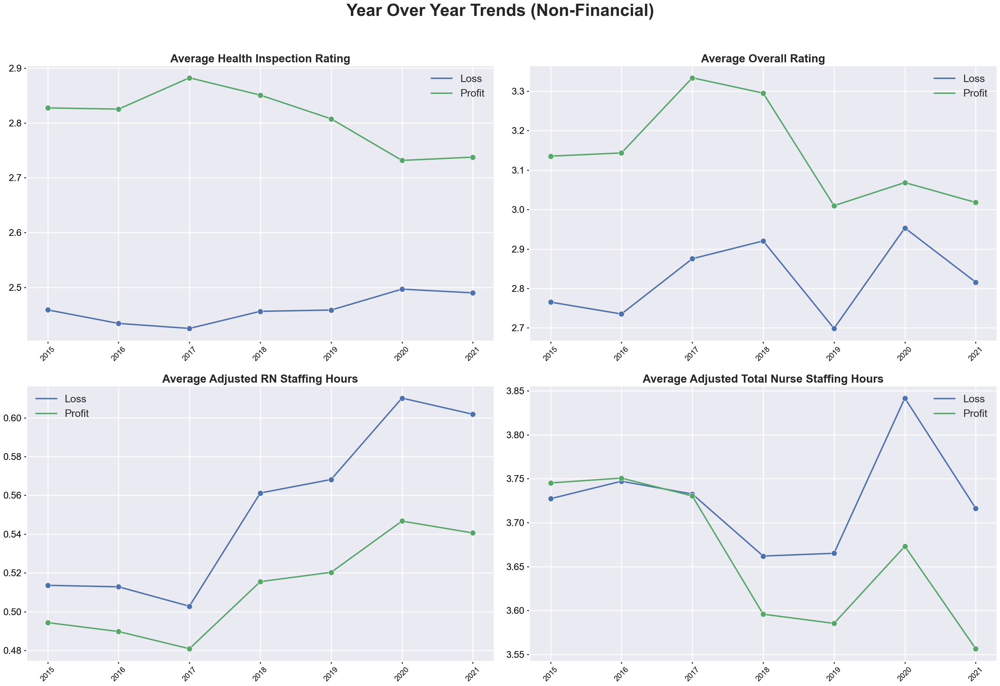

In [46]:
#iterate through columns to ID trends. 
trends = ['health_inspection_rating', 
       #   'total_days_total',
       #'total_rug_days',
      # 'number_of_fines', 
       'overall_rating',
      # 'average_occupied_bed_per_day', 
      # 'qm_rating',
       'adjusted_rn_staffing_hours_per_resident_per_day', 
      # 'staffing_rating',
       #'adjusted_total_nurse_staffing_hours_per_resident_per_day',
      # #'adjusted_lpn_staffing_hours_per_resident_per_day',
      # 'total_bed_days_available',
       'adjusted_total_nurse_staffing_hours_per_resident_per_day' 
       #'density',
       #'population'
       ]

#create easier to read titles 

column_titles = {
    'health_inspection_rating': 'Health Inspection Rating',
    #'total_days_total': 'Total Days Total',
    #'total_rug_days': 'Total RUG Days',
    #'number_of_fines': 'Number of Fines',
    'overall_rating': 'Overall Rating',
    #'average_occupied_bed_per_day': 'Occupied Bed Per Day',
   # 'qm_rating': 'QM Rating',
    'adjusted_rn_staffing_hours_per_resident_per_day': 'Adjusted RN Staffing Hours',
   # 'staffing_rating': 'Staffing Rating',
    'adjusted_total_nurse_staffing_hours_per_resident_per_day': 'Adjusted Total Nurse Staffing Hours',
    #'adjusted_lpn_staffing_hours_per_resident_per_day': 'Adjusted LPN Staffing Hours',
    #'total_bed_days_available': 'Total Bed Days Available',
    #'density': 'Population Density',
    #'population':'Total Population'
}

#set plotting context and instantiate plotting grid 
sns.set_context('poster')

fig, ax = plt.subplots(ncols=2,nrows=(len(trends) + 1) // 2,figsize=(30,30))

ax = ax.flatten()

for i,factor in enumerate(trends): 
    
    grouped = df.groupby(['cost_report_year','profit_loss'])\
        [[factor]].mean().reset_index()
    
    sns.lineplot(data=grouped,
                 x='cost_report_year',
                 y=factor,
                 hue='profit_loss',
                 ax=ax[i],
                 marker='o')
    
    ax[i].set_title(f'Average {column_titles[factor]}',
                    fontsize=24,fontweight='bold')
    
    #turn off label and legends 
    ax[i].set_xlabel('')
    ax[i].set_ylabel('')
    ax[i].legend()
    
    ax[i].tick_params(axis='x', labelsize=16, 
                      labelrotation=45, width=2, 
                      labelcolor='black', which='major',
                      direction='out', bottom=True, length=5,
                      pad=5)

    ax[i].tick_params(axis='y', labelsize=20,
                      width=2, labelcolor='black', which='major',
                      direction='out', left=True, length=5, pad=5)

    
fig.suptitle('Year Over Year Trends (Non-Financial)',
             fontsize=36,
             fontweight='bold')

fig.tight_layout(rect=[0,0.3,1,.97])

In the above plot we examine various "non-financial" factors and their trends over time, as well as the difference in profit vs loss firms. 

The columns of interest: 
* Staffing Hours 
* Ratings (Health Inspection, Staffing, Quality Rating)
* Total Bed Days Available 
* Total Days 
* Number of Fines

We chose these columns by using different non-parametric tests (ANOVA & independant sample t-tests) to find non-financial, statistically signficant differences. 

What we see: 

* Generally, staffing hours were higher during covid-19 and in firms that took a loss. 
* Profitable firms had lower fines, higher QM ratings, and less staffing hours. 
* Surprisingly profitable firms also had lower staffing ratings, but a much higher total rating.


merge in a variety of 3rd party demographic features 

* pct population above 65 

* median income 

* old age support KPI (see documentation for more) 

* avg percentage in poverty 

In [48]:
econ_pop = pd.read_csv('/Users/jack/Desktop/Data Analysis Practice/ManhattanProject/3rd Party Data/econ_pop.csv').infer_objects()

age_pop = pd.read_csv('/Users/jack/Desktop/Data Analysis Practice/ManhattanProject/3rd Party Data/age_pop.csv').infer_objects()

zips_geo = pd.read_csv('/Users/jack/Desktop/Data Analysis Practice/ManhattanProject/3rd Party Data/simplemaps_uszips_basicv1.84/uszips.csv',
            usecols=['zip','lat','lng','county_fips']
            )

#merge dataset to look at precovid geospatial visual
df_new = (df.reset_index().merge(zips_geo,
         left_on=['provider_zip_code.x'],
         right_on=['zip'],
         how='left')\
             .merge(age_pop[['FIPS','TimeFrame','perc_eld_pop','old_age_support']]\
                 
                 
                 .set_index(['FIPS','TimeFrame']),
                 left_on=['county_fips','cost_report_year'],
                 
                    right_index=True, how ='left'
)\
                        .merge(econ_pop[['FIPS','perc_poverty_avg','med_income_avg']],
                               left_on=['county_fips'],
                               right_on=['FIPS'],
                               how='left')).set_index('FIPS')

In [49]:
df.cost_report_year = df.cost_report_year.astype(int)

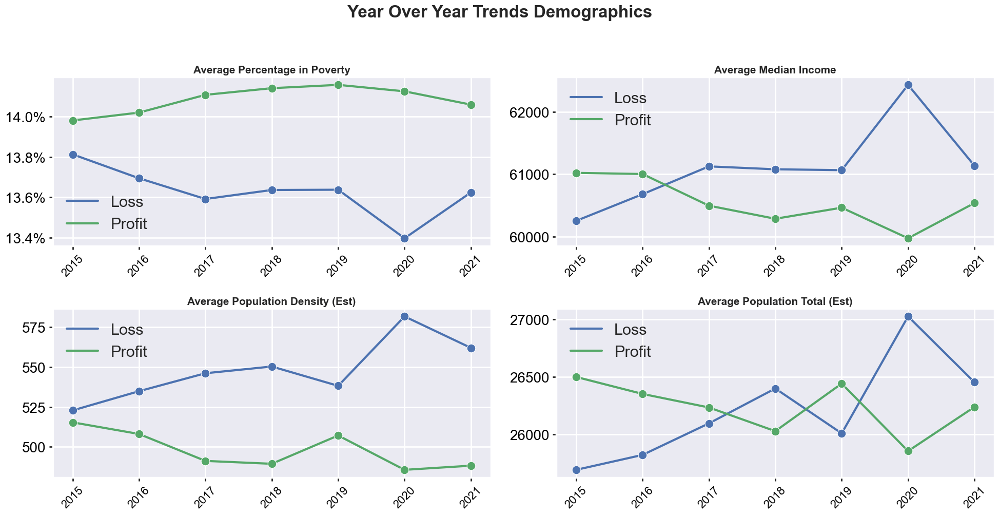

In [50]:
#define columns to plot and zip into plot titles dictionary 

demographics = ['perc_poverty_avg','med_income_avg','density','population','perc_eld_pop','old_age_support']

plot_titles = ['Percentage in Poverty','Median Income','Population Density (Est)','Population Total (Est)','Percentage Population Over 65','Old Age Support Rating']

column_titles = dict(zip(demographics,plot_titles))

fig, ax = plt.subplots(ncols=2,nrows=2,figsize=(20,15))

#flatten axes 
ax = ax.flatten()

#define percentage formatter for plots that need it 

from matplotlib.ticker import FuncFormatter

def percent_formatter(x,pos): 
    return '{:.1%}'.format(x)

#plot demographics 
for i,factor in enumerate(demographics): 
    
    if factor in ['perc_eld_pop','old_age_support']:
        continue
    
    grouped = df_new.groupby(['cost_report_year','profit_loss'])\
        [[factor]].mean().reset_index()
    
    sns.lineplot(data=grouped,
                 x='cost_report_year',
                 y=factor,
                 hue='profit_loss',
                 ax=ax[i],
                 marker='o')
    
    ax[i].set_title(f"Average {column_titles[factor]}",fontsize=15,fontweight='bold')
    
    #turn off label and legends 
    ax[i].set_xlabel('')
    ax[i].set_ylabel('')
    ax[i].legend()
    
       
    ax[i].tick_params(axis='x', labelsize=16, 
                      labelrotation=45, width=2, 
                      labelcolor='black', which='major',
                      direction='out', bottom=True, length=5,
                      pad=5)

    ax[i].tick_params(axis='y', labelsize=20,
                      width=2, labelcolor='black', which='major',
                      direction='out', left=True, length=5, pad=5)
    
    
    if factor in ['perc_poverty_avg','perc_eld_pop']: 
        
        ax[i].yaxis.set_major_formatter(FuncFormatter(percent_formatter))
    
fig.suptitle('Year Over Year Trends Demographics',
             fontsize=24,fontweight='bold')

fig.tight_layout(rect=[0,0.3,1,.97])

read in seaborn color palette for team

In [51]:
# Get the color palette associated with the style
palette = sns.color_palette()

# Loop through each color in the palette and print its RGB code
for color in palette:
    r, g, b = tuple(int(x * 255) for x in color)
    print(f"RGB: ({r}, {g}, {b})")

RGB: (76, 114, 176)
RGB: (85, 168, 104)
RGB: (196, 78, 82)
RGB: (129, 114, 178)
RGB: (204, 185, 116)
RGB: (100, 181, 205)


This plot shows yearly trends in demographic factors across all years (pre-covid). 

The fields include: 
* Percentage of Population in Poverty 
* Average Median Income 
* Average Population Density Estimate (this is actually 2020 census) 
* Average Population Total
* Average Percentage of Population over 65
* Average Old Age Support Rating 

These fields are plotted across all years and subsetted by profitable vs loss firms.

We see clearly that: 

* We see that high median income, population density and total population hurt profitability under normal conditions.

* This is reinforced by the increased likelihood of profitability in areas of high poverty. 

When steering back to regional differences, lets see if large covariates such as total days, beds per day, median income and percentage elderly can be controlled for. 

If this is the case this means that certain regions are better and there may be more to it than just the covariates. 

In [52]:
# how can we test if these variables explain some of the variance in net income? 

anova_tab = pg.ancova(data=df_new,
         dv='net_income',
         between='region',
         covar=['total_days_total',
                  'average_occupied_bed_per_day',
                  'perc_eld_pop',
                  'med_income_avg',
                  'population']) # these are heuristically some of the most important factors that changed overtime in profit/loss firms

anova_tab = anova_tab[anova_tab['p-unc'] < .01]
anova_tab

,Source,SS,DF,F,p-unc,np2
0,region,2.279698e+14,3,219.936887,1.074625e-141,0.013867
1,total_days_total,6.041747e+13,1,174.865687,7.549601e-40,0.003713
2,average_occupied_bed_per_day,5.235254e+12,1,15.152342,9.931226e-05,0.000323
4,med_income_avg,1.873408e+13,1,54.221861,1.820127e-13,0.001154
5,population,2.293313e+13,1,66.375130,3.818896e-16,0.001413


We see that region is significant irrespective of total days, average occupancy, median income and population.

 Percentage of population in poverty was not significant. 

In [53]:
posthoc = pg.pairwise_tukey(data=df_new,
                  dv='net_income',
                  between='region')

posthoc = posthoc[posthoc['p-tukey'] < .01] # subset for comparisons with very high confidence of hA

posthoc # does the test align with what we see in the sample? Answer: Yes

,A,B,mean(A),mean(B),diff,se,T,p-tukey,hedges
0,midwest,northeast,38237.042685,122244.928082,-84007.885397,5875.725953,-14.297448,0.000000e+00,-0.129895
1,midwest,southwest,38237.042685,86037.684005,-47800.641320,8033.328640,-5.950291,1.606542e-08,-0.080729
2,midwest,west,38237.042685,207993.962266,-169756.919581,7899.649302,-21.489172,0.000000e+00,-0.270012
3,northeast,southwest,122244.928082,86037.684005,36207.244077,7640.021782,4.739155,1.278530e-05,0.054846
4,northeast,west,122244.928082,207993.962266,-85749.034184,7499.334830,-11.434219,0.000000e+00,-0.125167
5,southwest,west,86037.684005,207993.962266,-121956.278261,9287.100540,-13.131793,0.000000e+00,-0.188779


Even after conducting ANCOVA to control for significant demographic factors, we find the best regions to invest are: 
* West 
* Northeast

In [54]:
px.scatter_geo(df_new,
               lat='lat',
               lon='lng',
               locationmode='USA-states',
               color='net_income',
               color_continuous_scale ='ylgnbu',
               scope='usa',
               title='Pre-Covid Profitability of U.S. Nursing Homes',
               opacity=.05)

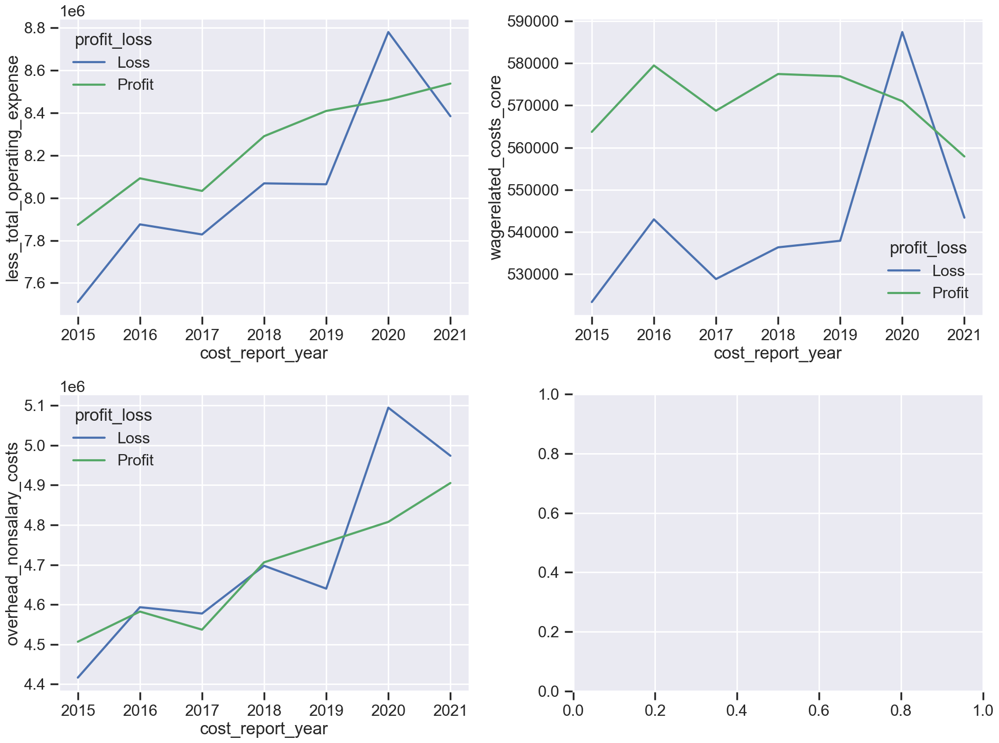

In [55]:
cost_piv = df_new.groupby(['cost_report_year','profit_loss'])\
    [['less_total_operating_expense', 'overhead_nonsalary_costs','wagerelated_costs_core']].mean().reset_index()

fig, ax = plt.subplots(figsize=(20,15),ncols=2,nrows=2)

ax = ax.flatten()

sns.lineplot(cost_piv,x='cost_report_year',
             y='less_total_operating_expense',
             hue='profit_loss',
             ax=ax[0]) 

sns.lineplot(cost_piv,x='cost_report_year',
             y='overhead_nonsalary_costs',
             hue='profit_loss',
             ax=ax[2]) 

sns.lineplot(cost_piv,x='cost_report_year',
             y='wagerelated_costs_core',
             hue='profit_loss',
             ax=ax[1]) 

plt.tight_layout()

In [57]:
df_new.to_csv('/Users/jack/Desktop/dataset_pt2.csv')